In [2]:
import os
import torch
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from PIL import Image

import zipfile
import os

# Path to your zip file
zip_path = "C:/Users/kghor/Downloads/OpenAnimalTracks.zip"
# Path where you want to extract the files
extract_path = "C:/Users/kghor/Downloads/OpenAnimalTracks_extracted"

# Create the extraction directory if it doesn't exist
os.makedirs(extract_path, exist_ok=True)

# Extract the files
with zipfile.ZipFile(zip_path, 'r') as zip_ref:
    zip_ref.extractall(extract_path)

print(f"Files extracted to {extract_path}")

# Now use the extracted path in your code
data_root = os.path.join(extract_path, "OpenAnimalTracks")
train_dir = os.path.join(data_root, "cropped_imgs/train")
val_dir = os.path.join(data_root, "cropped_imgs/val")
test_dir = os.path.join(data_root, "cropped_imgs/test")

# Create a custom dataset class
class AnimalTracksDataset(Dataset):
    def __init__(self, root_dir, transform=None):
        self.root_dir = root_dir
        self.transform = transform
        self.classes = sorted([d for d in os.listdir(root_dir) if os.path.isdir(os.path.join(root_dir, d))])
        self.class_to_idx = {cls_name: i for i, cls_name in enumerate(self.classes)}
        
        self.samples = []
        for class_name in self.classes:
            class_dir = os.path.join(root_dir, class_name)
            for img_name in os.listdir(class_dir):
                if img_name.endswith(('.jpg', '.jpeg', '.png')):
                    self.samples.append((os.path.join(class_dir, img_name), self.class_to_idx[class_name]))
    
    def __len__(self):
        return len(self.samples)
    
    def __getitem__(self, idx):
        img_path, label = self.samples[idx]
        image = Image.open(img_path).convert('RGB')
        
        if self.transform:
            image = self.transform(image)
            
        return image, label

# Define transformations
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

# Create datasets
train_dataset = AnimalTracksDataset(train_dir, transform=transform)
val_dataset = AnimalTracksDataset(val_dir, transform=transform)
test_dataset = AnimalTracksDataset(test_dir, transform=transform)

# Create dataloaders
batch_size = 32
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

# Print some information about the datasets
print(f"Number of training samples: {len(train_dataset)}")
print(f"Number of validation samples: {len(val_dataset)}")
print(f"Number of test samples: {len(test_dataset)}")
print(f"Number of classes: {len(train_dataset.classes)}")
print(f"Classes: {train_dataset.classes}")

Files extracted to C:/Users/kghor/Downloads/OpenAnimalTracks_extracted
Number of training samples: 2514
Number of validation samples: 346
Number of test samples: 719
Number of classes: 18
Classes: ['beaver', 'black_bear', 'bob_cat', 'coyote', 'elephant', 'goose', 'gray_fox', 'horse', 'lion', 'mink', 'mouse', 'muledeer', 'otter', 'raccoon', 'rat', 'skunk', 'turkey', 'western_grey_squirrel']


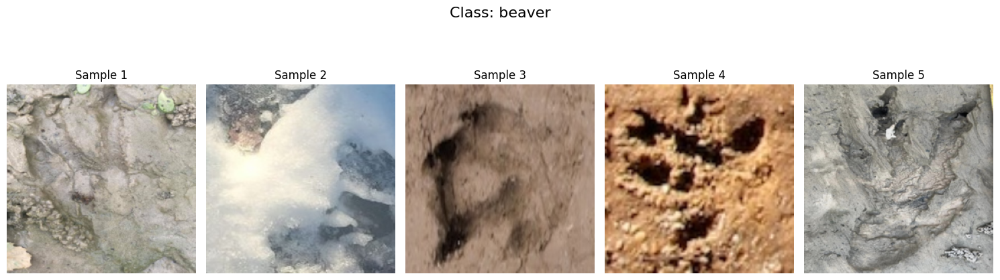

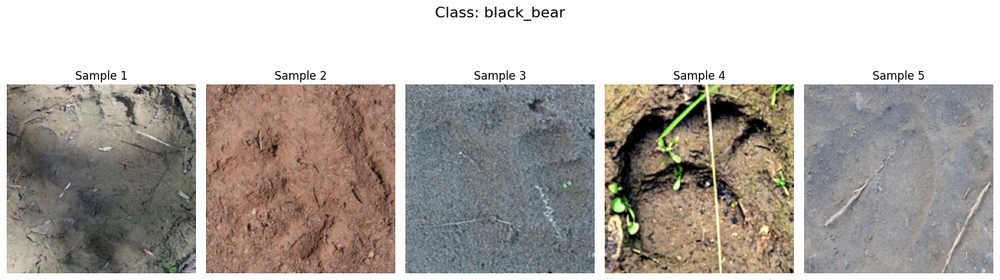

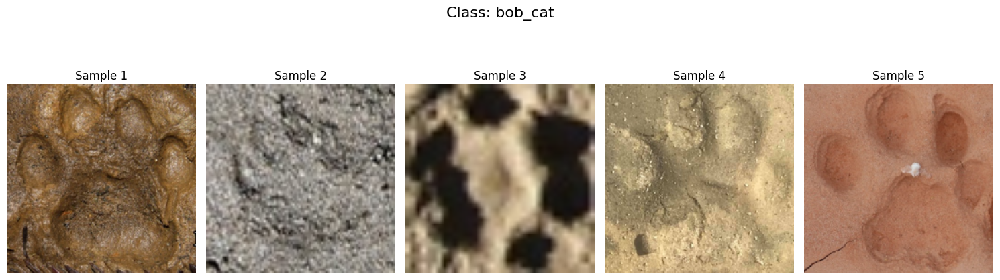

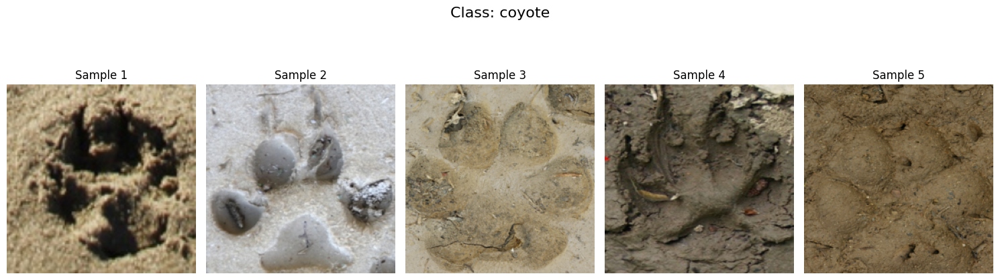

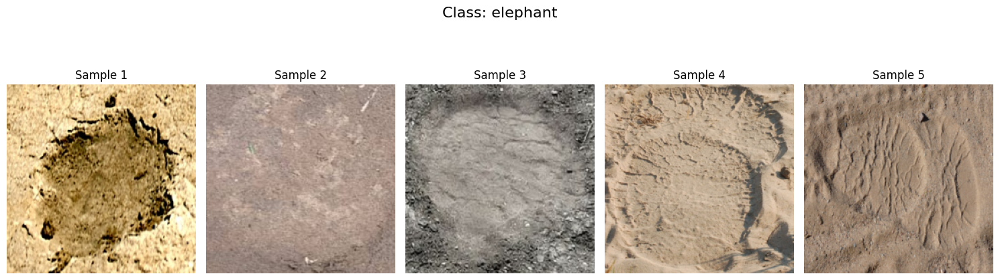

...

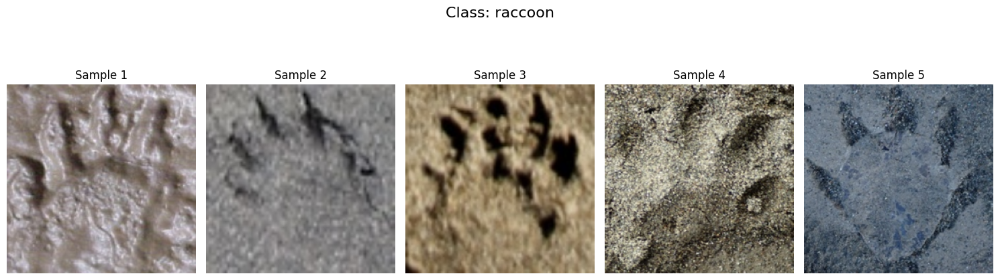

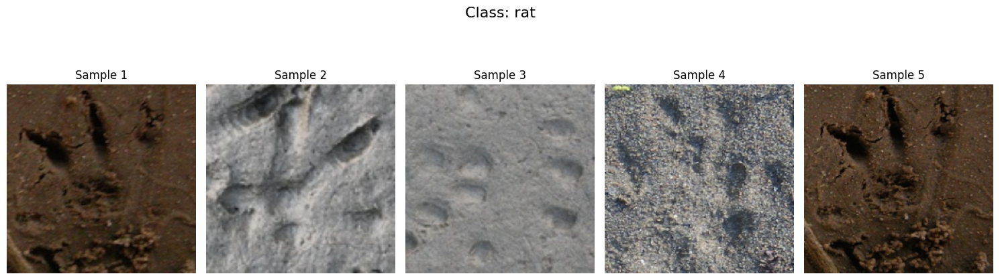

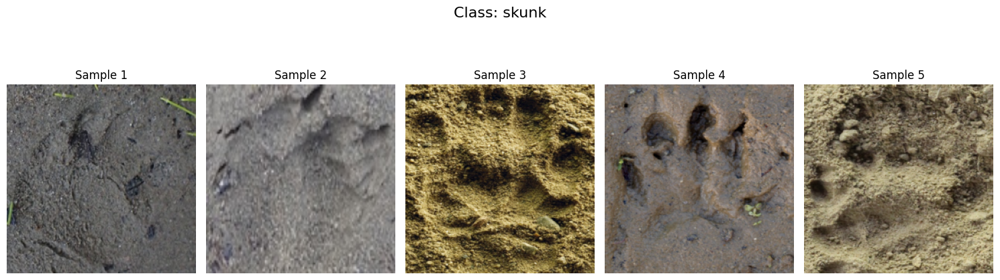

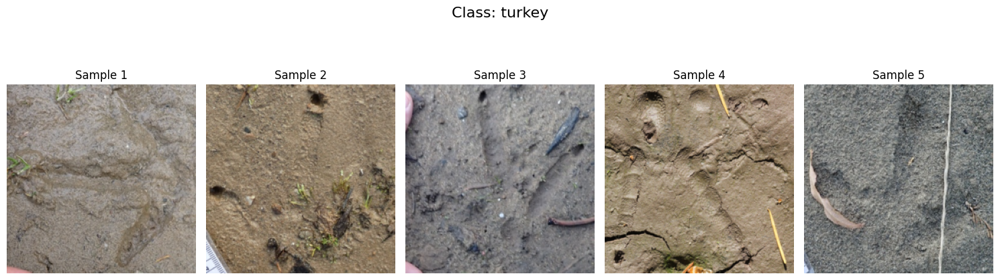

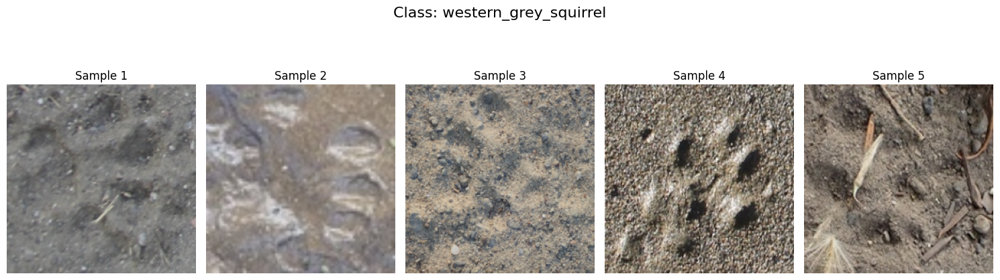

In [3]:
import matplotlib.pyplot as plt
import random
import numpy as np

def display_class_images(dataset, num_images=5):
    """
    Displays a specified number of random images from each class in the dataset.
    """
    # Create a dictionary mapping class index to list of image indices
    class_to_indices = {i: [] for i in range(len(dataset.classes))}
    
    # Populate the dictionary
    for idx, (_, label) in enumerate(dataset.samples):
        class_to_indices[label].append(idx)
    
    # Display images for each class
    for class_idx, class_name in enumerate(dataset.classes):
        # Get indices of images belonging to this class
        indices = class_to_indices[class_idx]
        
        # Select random images (or all if fewer than num_images exist)
        selected_indices = random.sample(indices, min(num_images, len(indices)))
        
        # Create a figure
        fig, axes = plt.subplots(1, len(selected_indices), figsize=(15, 5))
        
        # Display each selected image
        for i, idx in enumerate(selected_indices):
            # Get the image and convert from tensor to numpy array for display
            image, _ = dataset[idx]
            
            # Convert tensor to numpy array and transpose to correct dimensions
            img_np = image.numpy().transpose(1, 2, 0)
            
            # Denormalize the image for display
            mean = np.array([0.485, 0.456, 0.406])
            std = np.array([0.229, 0.224, 0.225])
            img_np = std * img_np + mean
            
            # Clip values to be between 0 and 1
            img_np = np.clip(img_np, 0, 1)
            
            # Display the image
            if len(selected_indices) > 1:
                axes[i].imshow(img_np)
                axes[i].set_title(f"Sample {i+1}")
                axes[i].axis('off')
            else:
                axes.imshow(img_np)
                axes.set_title(f"Sample {i+1}")
                axes.axis('off')
        
        plt.suptitle(f"Class: {class_name}", fontsize=16)
        plt.tight_layout()
        plt.show()

# Call the function to display images from the training dataset
display_class_images(train_dataset, 5)

In [4]:
import os
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms, models
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
import copy
import random
from tqdm import tqdm
from sklearn.metrics import confusion_matrix
import itertools
import time

# Custom animal tracks dataset class
class AnimalTracksDataset(Dataset):
    def __init__(self, root_dir, transform=None):
        self.root_dir = root_dir
        self.transform = transform
        self.classes = sorted([d for d in os.listdir(root_dir) if os.path.isdir(os.path.join(root_dir, d))])
        self.class_to_idx = {cls_name: i for i, cls_name in enumerate(self.classes)}
        
        self.samples = []
        for class_name in self.classes:
            class_dir = os.path.join(root_dir, class_name)
            for img_name in os.listdir(class_dir):
                if img_name.endswith(('.jpg', '.jpeg', '.png')):
                    self.samples.append((os.path.join(class_dir, img_name), self.class_to_idx[class_name]))
    
    def __len__(self):
        return len(self.samples)
    
    def __getitem__(self, idx):
        img_path, label = self.samples[idx]
        image = Image.open(img_path).convert('RGB')
        
        if self.transform:
            image = self.transform(image)
            
        return image, label

# Function to plot confusion matrix
def plot_confusion_matrix(cm, class_names, normalize=True, title='Confusion Matrix', cmap=plt.cm.Blues):
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
    
    plt.figure(figsize=(10, 8))
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    
    tick_marks = np.arange(len(class_names))
    plt.xticks(tick_marks, class_names, rotation=45, ha="right")
    plt.yticks(tick_marks, class_names)
    
    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        if cm[i, j] > 0:
            plt.text(j, i, format(cm[i, j], fmt),
                    horizontalalignment="center",
                    color="white" if cm[i, j] > thresh else "black")
    
    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    
    return plt

# Display sample images
def display_class_images(dataset, num_images=5):
    # Create a dictionary mapping class index to list of image indices
    class_to_indices = {i: [] for i in range(len(dataset.classes))}
    
    # Populate the dictionary
    for idx, (_, label) in enumerate(dataset.samples):
        class_to_indices[label].append(idx)
    
    # Display images for each class
    for class_idx, class_name in enumerate(dataset.classes):
        # Get indices of images belonging to this class
        indices = class_to_indices[class_idx]
        
        # Select random images (or all if fewer than num_images exist)
        selected_indices = random.sample(indices, min(num_images, len(indices)))
        
        # Create a figure
        fig, axes = plt.subplots(1, len(selected_indices), figsize=(15, 5))
        
        # Display each selected image
        for i, idx in enumerate(selected_indices):
            # Get the image and convert from tensor to numpy array for display
            image, _ = dataset[idx]
            
            # Convert tensor to numpy array and transpose to correct dimensions
            img_np = image.numpy().transpose(1, 2, 0)
            
            # Denormalize the image for display
            mean = np.array([0.485, 0.456, 0.406])
            std = np.array([0.229, 0.224, 0.225])
            img_np = std * img_np + mean
            
            # Clip values to be between 0 and 1
            img_np = np.clip(img_np, 0, 1)
            
            # Display the image
            if len(selected_indices) > 1:
                axes[i].imshow(img_np)
                axes[i].set_title(f"Sample {i+1}")
                axes[i].axis('off')
            else:
                axes.imshow(img_np)
                axes.set_title(f"Sample {i+1}")
                axes.axis('off')
        
        plt.suptitle(f"Class: {class_name}", fontsize=16)
        plt.tight_layout()
        plt.show()

# Training function
def train_model(model, train_loader, val_loader, criterion, optimizer, 
                scheduler, num_epochs, device):
    """
    Simple training function without pickling issues
    """
    since = time.time()
    
    # Initialize tracking variables
    best_model_wts = copy.deepcopy(model.state_dict())
    best_acc = 0.0
    train_losses = []
    val_losses = []
    train_accs = []
    val_accs = []
    
    # For each epoch
    for epoch in range(num_epochs):
        print(f'Epoch {epoch+1}/{num_epochs}')
        print('-' * 10)
        
        # Training phase
        model.train()
        running_loss = 0.0
        running_corrects = 0
        total_samples = 0
        
        # Iterate over training data
        for inputs, labels in tqdm(train_loader, desc="Training"):
            inputs = inputs.to(device)
            labels = labels.to(device)
            
            # Zero the parameter gradients
            optimizer.zero_grad()
            
            # Forward pass
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            
            # Backward pass and optimize
            loss.backward()
            optimizer.step()
            
            # Statistics
            _, preds = torch.max(outputs, 1)
            running_loss += loss.item() * inputs.size(0)
            running_corrects += torch.sum(preds == labels.data)
            total_samples += inputs.size(0)
        
        # Step the scheduler
        if scheduler:
            scheduler.step()
        
        # Calculate epoch metrics for training
        epoch_loss = running_loss / total_samples
        epoch_acc = running_corrects.double() / total_samples
        train_losses.append(epoch_loss)
        train_accs.append(epoch_acc.item())
        
        print(f'Training Loss: {epoch_loss:.4f} Acc: {epoch_acc:.4f}')
        
        # Validation phase
        model.eval()
        running_loss = 0.0
        running_corrects = 0
        total_samples = 0
        all_preds = []
        all_labels = []
        
        # No gradients needed for validation
        with torch.no_grad():
            for inputs, labels in tqdm(val_loader, desc="Validation"):
                inputs = inputs.to(device)
                labels = labels.to(device)
                
                # Forward pass
                outputs = model(inputs)
                _, preds = torch.max(outputs, 1)
                loss = criterion(outputs, labels)
                
                # Statistics
                running_loss += loss.item() * inputs.size(0)
                running_corrects += torch.sum(preds == labels.data)
                total_samples += inputs.size(0)
                
                # Store predictions and labels for confusion matrix
                all_preds.extend(preds.cpu().numpy())
                all_labels.extend(labels.cpu().numpy())
        
        # Calculate epoch metrics for validation
        epoch_loss = running_loss / total_samples
        epoch_acc = running_corrects.double() / total_samples
        val_losses.append(epoch_loss)
        val_accs.append(epoch_acc.item())
        
        print(f'Validation Loss: {epoch_loss:.4f} Acc: {epoch_acc:.4f}')
        
        # Save best model
        if epoch_acc > best_acc:
            best_acc = epoch_acc
            best_model_wts = copy.deepcopy(model.state_dict())
            print(f'New best model with accuracy: {best_acc:.4f}')
        
        print()
    
    # Training complete
    time_elapsed = time.time() - since
    print(f'Training completed in {time_elapsed // 60:.0f}m {time_elapsed % 60:.0f}s')
    print(f'Best validation accuracy: {best_acc:.4f}')
    
    # Load best model weights
    model.load_state_dict(best_model_wts)
    
    # Plot training curves
    plt.figure(figsize=(12, 5))
    plt.subplot(1, 2, 1)
    plt.plot(range(1, num_epochs+1), train_losses, label='Training Loss')
    plt.plot(range(1, num_epochs+1), val_losses, label='Validation Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()
    
    plt.subplot(1, 2, 2)
    plt.plot(range(1, num_epochs+1), train_accs, label='Training Accuracy')
    plt.plot(range(1, num_epochs+1), val_accs, label='Validation Accuracy')
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.legend()
    
    plt.show()
    
    return model, best_acc

# Evaluation function
def evaluate_model(model, data_loader, device, class_names=None):
    """
    Evaluates the model on a given dataset
    """
    model.eval()
    running_corrects = 0
    total_samples = 0
    all_preds = []
    all_labels = []
    
    # No gradients needed for evaluation
    with torch.no_grad():
        for inputs, labels in tqdm(data_loader, desc="Evaluating"):
            inputs = inputs.to(device)
            labels = labels.to(device)
            
            # Forward pass
            outputs = model(inputs)
            _, preds = torch.max(outputs, 1)
            
            # Statistics
            running_corrects += torch.sum(preds == labels.data)
            total_samples += inputs.size(0)
            
            # Store predictions and labels for confusion matrix
            all_preds.extend(preds.cpu().numpy())
            all_labels.extend(labels.cpu().numpy())
    
    # Calculate metrics
    accuracy = running_corrects.double() / total_samples
    
    # Create confusion matrix
    confusion_mat = confusion_matrix(all_labels, all_preds)
    
    # If class names are provided, plot confusion matrix
    if class_names:
        plt.figure(figsize=(10, 8))
        plot_confusion_matrix(confusion_mat, class_names)
        plt.title('Test Set Confusion Matrix')
        plt.show()
        
        # Calculate per-class accuracy
        print("\nPer-class accuracy:")
        for i, class_name in enumerate(class_names):
            class_total = np.sum(np.array(all_labels) == i)
            if class_total > 0:
                class_correct = confusion_mat[i, i]
                class_acc = class_correct / class_total
                print(f"{class_name}: {class_acc:.4f}")
    
    return accuracy.item(), confusion_mat

Using device: cpu
Number of training samples: 2514
Number of validation samples: 346
Number of test samples: 719
Number of classes: 18
Classes: ['beaver', 'black_bear', 'bob_cat', 'coyote', 'elephant', 'goose', 'gray_fox', 'horse', 'lion', 'mink', 'mouse', 'muledeer', 'otter', 'raccoon', 'rat', 'skunk', 'turkey', 'western_grey_squirrel']
Epoch 1/40
----------


Training: 100%|██████████| 79/79 [04:42<00:00,  3.57s/it]


Training Loss: 2.5933 Acc: 0.1850


Validation: 100%|██████████| 11/11 [00:13<00:00,  1.26s/it]


Validation Loss: 3.2527 Acc: 0.1994
New best model with accuracy: 0.1994

Epoch 2/40
----------


Training: 100%|██████████| 79/79 [04:16<00:00,  3.25s/it]


Training Loss: 2.2568 Acc: 0.2796


Validation: 100%|██████████| 11/11 [00:11<00:00,  1.03s/it]


Validation Loss: 2.2610 Acc: 0.2688
New best model with accuracy: 0.2688

Epoch 3/40
----------


Training: 100%|██████████| 79/79 [04:13<00:00,  3.21s/it]


Training Loss: 2.0256 Acc: 0.3492


Validation: 100%|██████████| 11/11 [00:10<00:00,  1.02it/s]


Validation Loss: 3.0837 Acc: 0.2486

Epoch 4/40
----------


Training: 100%|██████████| 79/79 [04:05<00:00,  3.11s/it]


Training Loss: 1.8398 Acc: 0.3862


Validation: 100%|██████████| 11/11 [00:11<00:00,  1.00s/it]


Validation Loss: 2.0347 Acc: 0.3555
New best model with accuracy: 0.3555

Epoch 5/40
----------


Training: 100%|██████████| 79/79 [04:12<00:00,  3.20s/it]


Training Loss: 1.5996 Acc: 0.4682


Validation: 100%|██████████| 11/11 [00:10<00:00,  1.03it/s]


Validation Loss: 1.7358 Acc: 0.4942
New best model with accuracy: 0.4942

Epoch 6/40
----------


Training: 100%|██████████| 79/79 [04:05<00:00,  3.11s/it]


Training Loss: 1.4197 Acc: 0.5330


Validation: 100%|██████████| 11/11 [00:10<00:00,  1.01it/s]


Validation Loss: 1.9875 Acc: 0.4306

Epoch 7/40
----------


Training: 100%|██████████| 79/79 [04:04<00:00,  3.10s/it]


Training Loss: 1.3273 Acc: 0.5748


Validation: 100%|██████████| 11/11 [00:11<00:00,  1.01s/it]


Validation Loss: 1.7679 Acc: 0.4769

Epoch 8/40
----------


Training: 100%|██████████| 79/79 [04:10<00:00,  3.17s/it]


Training Loss: 1.0110 Acc: 0.6778


Validation: 100%|██████████| 11/11 [00:10<00:00,  1.01it/s]


Validation Loss: 1.2815 Acc: 0.5838
New best model with accuracy: 0.5838

Epoch 9/40
----------


Training: 100%|██████████| 79/79 [04:06<00:00,  3.12s/it]


Training Loss: 0.8250 Acc: 0.7379


Validation: 100%|██████████| 11/11 [00:10<00:00,  1.04it/s]


Validation Loss: 1.2241 Acc: 0.6069
New best model with accuracy: 0.6069

Epoch 10/40
----------


Training: 100%|██████████| 79/79 [04:04<00:00,  3.10s/it]


Training Loss: 0.7241 Acc: 0.7729


Validation: 100%|██████████| 11/11 [00:10<00:00,  1.03it/s]


Validation Loss: 1.1932 Acc: 0.6503
New best model with accuracy: 0.6503

Epoch 11/40
----------


Training: 100%|██████████| 79/79 [04:05<00:00,  3.11s/it]


Training Loss: 0.6888 Acc: 0.7737


Validation: 100%|██████████| 11/11 [00:10<00:00,  1.02it/s]


Validation Loss: 1.2154 Acc: 0.6387

Epoch 12/40
----------


Training: 100%|██████████| 79/79 [04:06<00:00,  3.12s/it]


Training Loss: 0.6216 Acc: 0.8039


Validation: 100%|██████████| 11/11 [00:10<00:00,  1.01it/s]


Validation Loss: 1.2011 Acc: 0.6243

Epoch 13/40
----------


Training: 100%|██████████| 79/79 [04:06<00:00,  3.12s/it]


Training Loss: 0.5574 Acc: 0.8274


Validation: 100%|██████████| 11/11 [00:10<00:00,  1.02it/s]


Validation Loss: 1.2287 Acc: 0.6243

Epoch 14/40
----------


Training: 100%|██████████| 79/79 [04:07<00:00,  3.13s/it]


Training Loss: 0.5420 Acc: 0.8309


Validation: 100%|██████████| 11/11 [00:10<00:00,  1.01it/s]


Validation Loss: 1.2081 Acc: 0.6329

Epoch 15/40
----------


Training: 100%|██████████| 79/79 [04:11<00:00,  3.18s/it]


Training Loss: 0.4706 Acc: 0.8584


Validation: 100%|██████████| 11/11 [00:11<00:00,  1.03s/it]


Validation Loss: 1.1878 Acc: 0.6445

Epoch 16/40
----------


Training: 100%|██████████| 79/79 [04:07<00:00,  3.13s/it]


Training Loss: 0.4512 Acc: 0.8656


Validation: 100%|██████████| 11/11 [00:10<00:00,  1.02it/s]


Validation Loss: 1.1830 Acc: 0.6474

Epoch 17/40
----------


Training: 100%|██████████| 79/79 [04:06<00:00,  3.12s/it]


Training Loss: 0.4184 Acc: 0.8819


Validation: 100%|██████████| 11/11 [00:10<00:00,  1.01it/s]


Validation Loss: 1.1623 Acc: 0.6474

Epoch 18/40
----------


Training: 100%|██████████| 79/79 [04:05<00:00,  3.11s/it]


Training Loss: 0.4471 Acc: 0.8691


Validation: 100%|██████████| 11/11 [00:10<00:00,  1.01it/s]


Validation Loss: 1.1802 Acc: 0.6503

Epoch 19/40
----------


Training: 100%|██████████| 79/79 [04:06<00:00,  3.12s/it]


Training Loss: 0.4249 Acc: 0.8743


Validation: 100%|██████████| 11/11 [00:10<00:00,  1.00it/s]


Validation Loss: 1.1764 Acc: 0.6474

Epoch 20/40
----------


Training: 100%|██████████| 79/79 [04:06<00:00,  3.11s/it]


Training Loss: 0.4315 Acc: 0.8787


Validation: 100%|██████████| 11/11 [00:11<00:00,  1.01s/it]


Validation Loss: 1.1718 Acc: 0.6561
New best model with accuracy: 0.6561

Epoch 21/40
----------


Training: 100%|██████████| 79/79 [04:05<00:00,  3.11s/it]


Training Loss: 0.4149 Acc: 0.8755


Validation: 100%|██████████| 11/11 [00:10<00:00,  1.02it/s]


Validation Loss: 1.1672 Acc: 0.6387

Epoch 22/40
----------


Training: 100%|██████████| 79/79 [04:05<00:00,  3.11s/it]


Training Loss: 0.4035 Acc: 0.8866


Validation: 100%|██████████| 11/11 [00:11<00:00,  1.03s/it]


Validation Loss: 1.1717 Acc: 0.6532

Epoch 23/40
----------


Training: 100%|██████████| 79/79 [04:11<00:00,  3.18s/it]


Training Loss: 0.3897 Acc: 0.8914


Validation: 100%|██████████| 11/11 [00:10<00:00,  1.02it/s]


Validation Loss: 1.1730 Acc: 0.6532

Epoch 24/40
----------


Training: 100%|██████████| 79/79 [04:04<00:00,  3.10s/it]


Training Loss: 0.4061 Acc: 0.8846


Validation: 100%|██████████| 11/11 [00:10<00:00,  1.02it/s]


Validation Loss: 1.1753 Acc: 0.6474

Epoch 25/40
----------


Training: 100%|██████████| 79/79 [04:05<00:00,  3.10s/it]


Training Loss: 0.3794 Acc: 0.8910


Validation: 100%|██████████| 11/11 [00:10<00:00,  1.01it/s]


Validation Loss: 1.1610 Acc: 0.6532

Epoch 26/40
----------


Training: 100%|██████████| 79/79 [04:05<00:00,  3.10s/it]


Training Loss: 0.3990 Acc: 0.8850


Validation: 100%|██████████| 11/11 [00:10<00:00,  1.02it/s]


Validation Loss: 1.1657 Acc: 0.6445

Epoch 27/40
----------


Training: 100%|██████████| 79/79 [04:04<00:00,  3.10s/it]


Training Loss: 0.4049 Acc: 0.8874


Validation: 100%|██████████| 11/11 [00:10<00:00,  1.01it/s]


Validation Loss: 1.1660 Acc: 0.6618
New best model with accuracy: 0.6618

Epoch 28/40
----------


Training: 100%|██████████| 79/79 [04:05<00:00,  3.11s/it]


Training Loss: 0.4068 Acc: 0.8807


Validation: 100%|██████████| 11/11 [00:10<00:00,  1.02it/s]


Validation Loss: 1.1657 Acc: 0.6561

Epoch 29/40
----------


Training: 100%|██████████| 79/79 [04:04<00:00,  3.09s/it]


Training Loss: 0.3882 Acc: 0.8926


Validation: 100%|██████████| 11/11 [00:10<00:00,  1.02it/s]


Validation Loss: 1.1629 Acc: 0.6503

Epoch 30/40
----------


Training: 100%|██████████| 79/79 [04:08<00:00,  3.14s/it]


Training Loss: 0.4087 Acc: 0.8827


Validation: 100%|██████████| 11/11 [00:10<00:00,  1.01it/s]


Validation Loss: 1.1636 Acc: 0.6387

Epoch 31/40
----------


Training: 100%|██████████| 79/79 [04:06<00:00,  3.12s/it]


Training Loss: 0.4019 Acc: 0.8870


Validation: 100%|██████████| 11/11 [00:10<00:00,  1.02it/s]


Validation Loss: 1.1739 Acc: 0.6561

Epoch 32/40
----------


Training: 100%|██████████| 79/79 [04:05<00:00,  3.10s/it]


Training Loss: 0.3908 Acc: 0.8902


Validation: 100%|██████████| 11/11 [00:10<00:00,  1.02it/s]


Validation Loss: 1.1658 Acc: 0.6503

Epoch 33/40
----------


Training: 100%|██████████| 79/79 [04:05<00:00,  3.10s/it]


Training Loss: 0.3850 Acc: 0.8906


Validation: 100%|██████████| 11/11 [00:10<00:00,  1.01it/s]


Validation Loss: 1.1860 Acc: 0.6445

Epoch 34/40
----------


Training: 100%|██████████| 79/79 [04:05<00:00,  3.11s/it]


Training Loss: 0.4031 Acc: 0.8807


Validation: 100%|██████████| 11/11 [00:10<00:00,  1.02it/s]


Validation Loss: 1.1627 Acc: 0.6618

Epoch 35/40
----------


Training: 100%|██████████| 79/79 [04:05<00:00,  3.11s/it]


Training Loss: 0.4019 Acc: 0.8866


Validation: 100%|██████████| 11/11 [00:10<00:00,  1.03it/s]


Validation Loss: 1.1613 Acc: 0.6532

Epoch 36/40
----------


Training: 100%|██████████| 79/79 [04:04<00:00,  3.10s/it]


Training Loss: 0.3993 Acc: 0.8890


Validation: 100%|██████████| 11/11 [00:10<00:00,  1.02it/s]


Validation Loss: 1.1564 Acc: 0.6561

Epoch 37/40
----------


Training: 100%|██████████| 79/79 [04:04<00:00,  3.10s/it]


Training Loss: 0.3927 Acc: 0.8894


Validation: 100%|██████████| 11/11 [00:10<00:00,  1.02it/s]


Validation Loss: 1.1724 Acc: 0.6561

Epoch 38/40
----------


Training: 100%|██████████| 79/79 [04:08<00:00,  3.14s/it]


Training Loss: 0.4007 Acc: 0.8815


Validation: 100%|██████████| 11/11 [00:10<00:00,  1.01it/s]


Validation Loss: 1.1726 Acc: 0.6387

Epoch 39/40
----------


Training: 100%|██████████| 79/79 [04:05<00:00,  3.10s/it]


Training Loss: 0.3895 Acc: 0.8866


Validation: 100%|██████████| 11/11 [00:10<00:00,  1.02it/s]


Validation Loss: 1.1703 Acc: 0.6503

Epoch 40/40
----------


Training: 100%|██████████| 79/79 [04:06<00:00,  3.11s/it]


Training Loss: 0.3974 Acc: 0.8902


Validation: 100%|██████████| 11/11 [00:10<00:00,  1.01it/s]


Validation Loss: 1.1677 Acc: 0.6474

Training completed in 172m 26s
Best validation accuracy: 0.6618


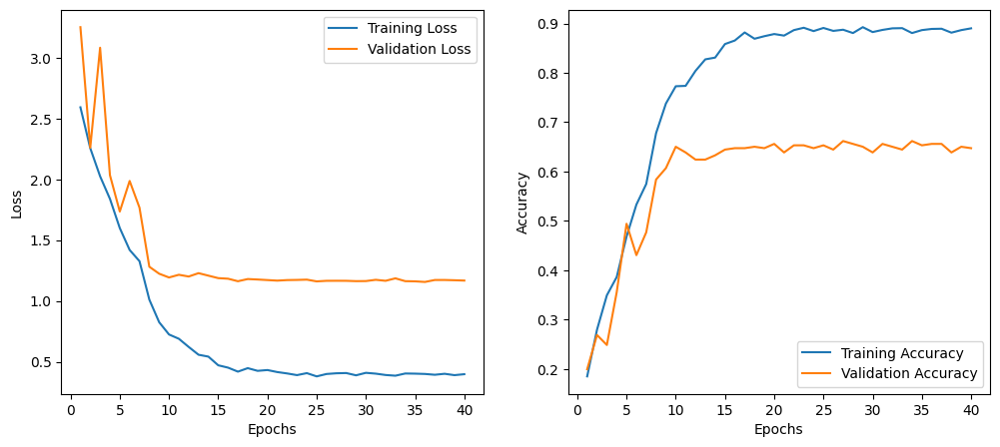

Evaluating: 100%|██████████| 23/23 [00:27<00:00,  1.21s/it]


<Figure size 1000x800 with 0 Axes>

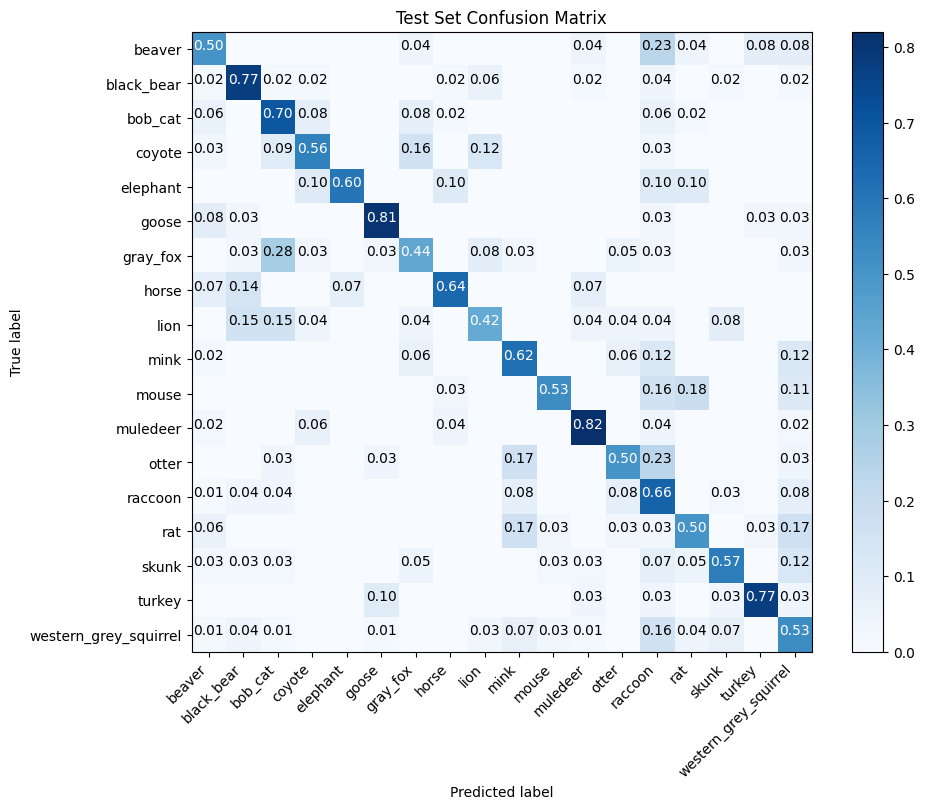


Per-class accuracy:
beaver: 0.5000
black_bear: 0.7736
bob_cat: 0.6981
coyote: 0.5625
elephant: 0.6000
goose: 0.8056
gray_fox: 0.4359
horse: 0.6429
lion: 0.4231
mink: 0.6200
mouse: 0.5263
muledeer: 0.8200
otter: 0.5000
raccoon: 0.6582
rat: 0.5000
skunk: 0.5750
turkey: 0.7742
western_grey_squirrel: 0.5263
Test accuracy: 0.6189
Displaying sample images from the training set:


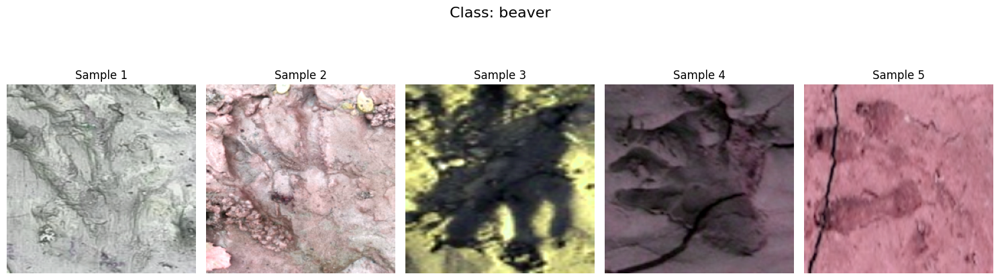

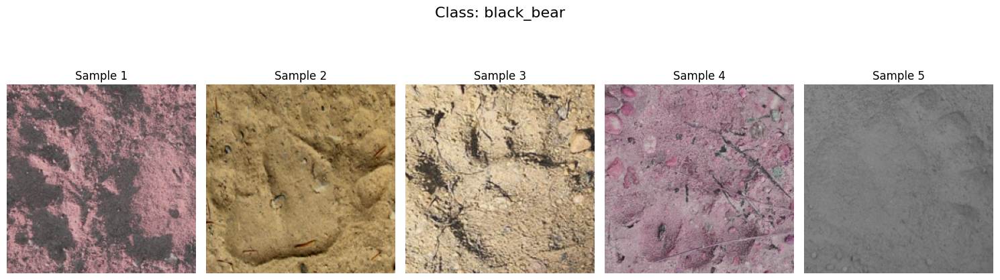

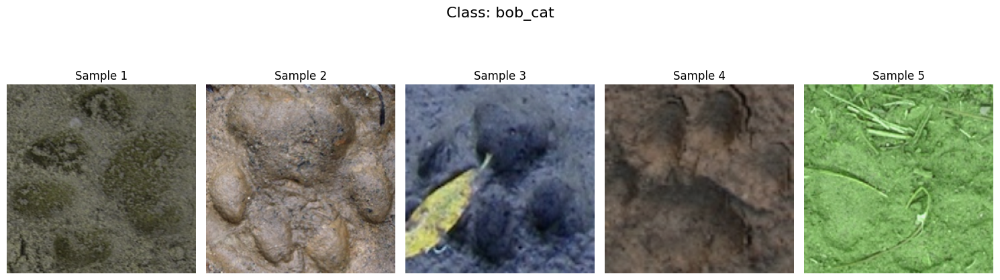

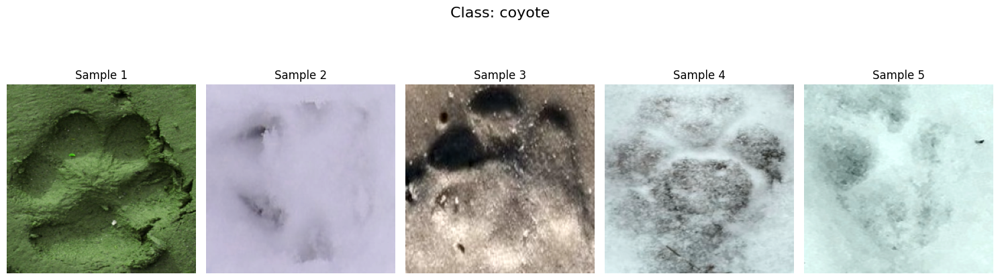

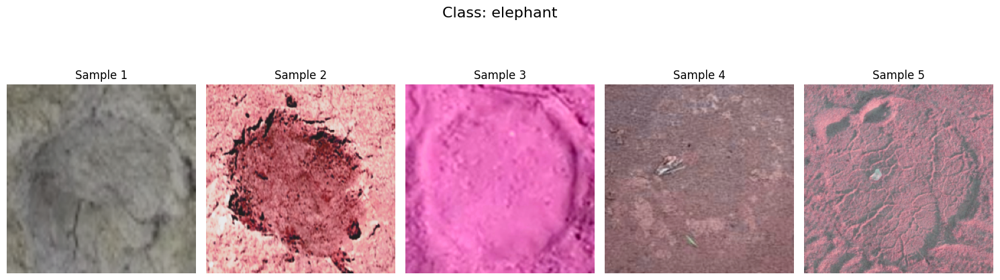

...

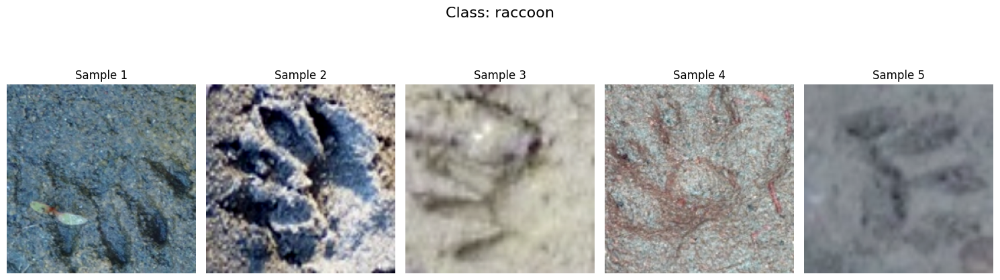

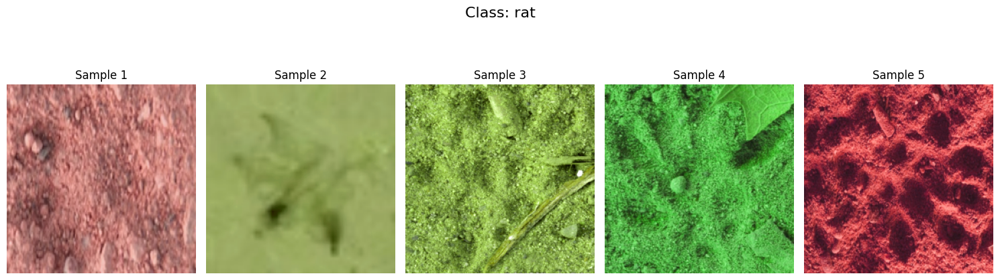

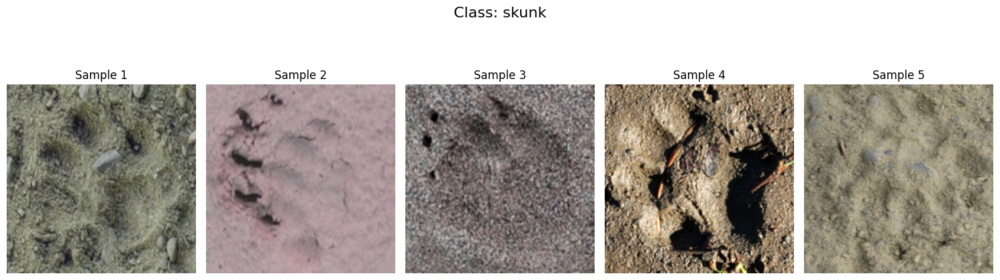

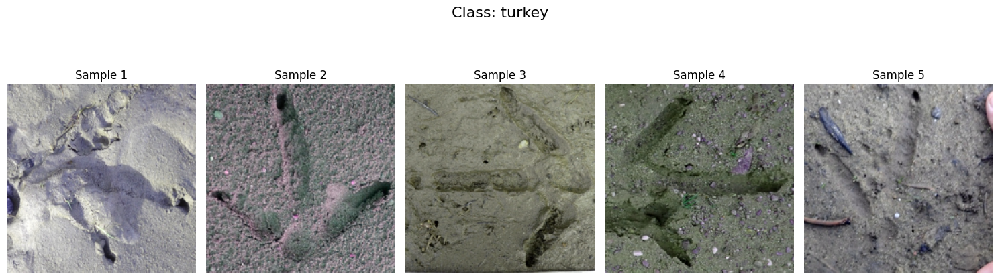

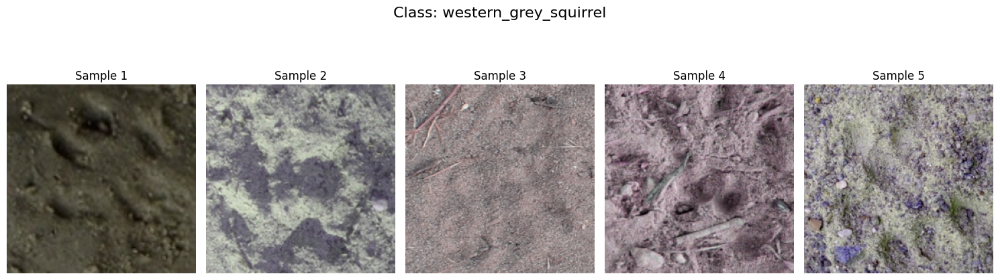

In [5]:
# Main function to run the training
def run_training():
    # Set random seeds for reproducibility
    torch.manual_seed(42)
    random.seed(42)
    np.random.seed(42)
    
    # Define your paths here
    extract_path = "C:/Users/kghor/Downloads/OpenAnimalTracks_extracted"
    data_root = os.path.join(extract_path, "OpenAnimalTracks")
    train_dir = os.path.join(data_root, "cropped_imgs/train")
    val_dir = os.path.join(data_root, "cropped_imgs/val")
    test_dir = os.path.join(data_root, "cropped_imgs/test")
    
    # Device configuration
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    print(f"Using device: {device}")
    
    # Simple transforms without custom transforms that need pickling
    train_transform = transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.RandomHorizontalFlip(),
        transforms.RandomVerticalFlip(),
        transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.2),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ])
    
    val_transform = transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ])
    
    # Create datasets
    train_dataset = AnimalTracksDataset(train_dir, transform=train_transform)
    val_dataset = AnimalTracksDataset(val_dir, transform=val_transform)
    test_dataset = AnimalTracksDataset(test_dir, transform=val_transform)
    
    # Create dataloaders with NO workers to avoid pickling
    batch_size = 32
    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=0)
    val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False, num_workers=0)
    test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, num_workers=0)
    
    # Print dataset information
    print(f"Number of training samples: {len(train_dataset)}")
    print(f"Number of validation samples: {len(val_dataset)}")
    print(f"Number of test samples: {len(test_dataset)}")
    print(f"Number of classes: {len(train_dataset.classes)}")
    print(f"Classes: {train_dataset.classes}")
    
    # Create model
    # For ResNet, use a simpler initialization approach
    model = models.resnet18()
    if hasattr(models.ResNet18_Weights, 'IMAGENET1K_V1'):
        # Newer PyTorch versions
        model = models.resnet18(weights=models.ResNet18_Weights.IMAGENET1K_V1)
    else:
        # Older PyTorch versions
        model = models.resnet18(pretrained=True)
    
    num_classes = len(train_dataset.classes)
    # Replace the final fully connected layer
    model.fc = nn.Linear(model.fc.in_features, num_classes)
    model = model.to(device)
    
    # Loss function, optimizer, and scheduler
    criterion = nn.CrossEntropyLoss()
    optimizer = optim.Adam(model.parameters(), lr=0.001, weight_decay=1e-4)
    # Learning rate scheduler
    scheduler = optim.lr_scheduler.StepLR(optimizer, step_size=7, gamma=0.1)
    
    # Train and evaluate the model
    model, best_acc = train_model(
        model=model,
        train_loader=train_loader,
        val_loader=val_loader,
        criterion=criterion,
        optimizer=optimizer,
        scheduler=scheduler,
        num_epochs=40,  # Start with fewer epochs for testing
        device=device
    )
    
    # Save the model
    os.makedirs('models', exist_ok=True)
    torch.save(model.state_dict(), 'models/animal_tracks_model.pth')
    
    # Evaluate on test set
    test_acc, test_cm = evaluate_model(model, test_loader, device, train_dataset.classes)
    print(f'Test accuracy: {test_acc:.4f}')
    
    # Display sample images
    print("Displaying sample images from the training set:")
    display_class_images(train_dataset, 5)

if __name__ == "__main__":
    run_training()